# FS7T04 CZ1015 Mini-Project
---
### Dataset 2: Modelling Earthquake Damage
Dataset from DrivenData : Richter's Predictor: Modeling Earthquake Damage

Source: https://www.drivendata.org/competitions/57/nepal-earthquake/

Problem: Classification

---
# Part 1

---
## Problem Statements 
---

**Data Exploration and Visualization**

- What are the most important factors which affect the damage grade of the buildings? (Part 1 and 2)- **Chiah Soon and Stanley**

- What are the 'ideal' materials to be used in the construction of a building that would help the building suffer the least damage? (Part 2) -**Garg Astha**

**Classification model training and testing**

- Predict the damage grade of the buildings by training the models based on the given dataset. (Part 2) - **Chiah Soon, Garg Astha and Stanley**

- Create your own building. Predict the damage it might suffer in case of earthquake. (Part 2) - **Garg Astha**



# Essential Libraries
---
Let us begin by importing the essential Python Libraries.

> NumPy : Library for Numeric Computations in Python  
> Pandas : Library for Data Acquisition and Preparation  
> Matplotlib : Low-level library for Data Visualization  
> Seaborn : Higher-level library for Data Visualization  

In [1]:
import pandas as pd
import numpy as np
import seaborn as sb
sb.set() # set the default Seaborn style for graphics
import matplotlib.pyplot as plt
%matplotlib inline

---
# Data Acquisition and Basic Statistics
---

### Setup : Import the Dataset

In [2]:
# Importing the data from the files
train_values=pd.read_csv('train_values.csv')
train_labels=pd.read_csv('train_labels.csv')

---
Checking the imported dataset

In [3]:
train_values.head()

,building_id,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,...,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
0,802906,6,487,12198,2,30,6,5,t,r,...,0,0,0,0,0,0,0,0,0,0
1,28830,8,900,2812,2,10,8,7,o,r,...,0,0,0,0,0,0,0,0,0,0
2,94947,21,363,8973,2,10,5,5,t,r,...,0,0,0,0,0,0,0,0,0,0
3,590882,22,418,10694,2,10,6,5,t,r,...,0,0,0,0,0,0,0,0,0,0
4,201944,11,131,1488,3,30,8,9,t,r,...,0,0,0,0,0,0,0,0,0,0


In [4]:
train_labels.head()

,building_id,damage_grade
0,802906,3
1,28830,2
2,94947,3
3,590882,2
4,201944,3


---
Since `building_id` is a unique and random identifier for each building in Nepal, it does not add any value for analysis and shall be removed.

In [5]:
train_values=train_values.drop('building_id',axis=1)
train_labels=train_labels.drop('building_id',axis=1)

In [6]:
train_values.head()

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,...,has_secondary_use_agriculture,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other
0,6,487,12198,2,30,6,5,t,r,n,...,0,0,0,0,0,0,0,0,0,0
1,8,900,2812,2,10,8,7,o,r,n,...,0,0,0,0,0,0,0,0,0,0
2,21,363,8973,2,10,5,5,t,r,n,...,0,0,0,0,0,0,0,0,0,0
3,22,418,10694,2,10,6,5,t,r,n,...,0,0,0,0,0,0,0,0,0,0
4,11,131,1488,3,30,8,9,t,r,n,...,0,0,0,0,0,0,0,0,0,0


In [7]:
train_labels.head()

,damage_grade
0,3
1,2
2,3
3,2
4,3


---
Here, we add the `damage_grade` column from `train_labels` to the columns of `train_values` to create a single dataframe `combined_train` that we will use for exploration and analysis.

In [8]:
combined_train = pd.concat([train_values, train_labels], axis = 1)
combined_train.head()

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,...,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,damage_grade
0,6,487,12198,2,30,6,5,t,r,n,...,0,0,0,0,0,0,0,0,0,3
1,8,900,2812,2,10,8,7,o,r,n,...,0,0,0,0,0,0,0,0,0,2
2,21,363,8973,2,10,5,5,t,r,n,...,0,0,0,0,0,0,0,0,0,3
3,22,418,10694,2,10,6,5,t,r,n,...,0,0,0,0,0,0,0,0,0,2
4,11,131,1488,3,30,8,9,t,r,n,...,0,0,0,0,0,0,0,0,0,3


In [9]:
print("Data type for combined_train: ", type(combined_train))
print("Data dims for combined_train: ", combined_train.shape)

Data type for combined_train:  <class 'pandas.core.frame.DataFrame'>
Data dims for combined_train:  (260601, 39)


In [10]:
combined_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260601 entries, 0 to 260600
Data columns (total 39 columns):
 #   Column                                  Non-Null Count   Dtype 
---  ------                                  --------------   ----- 
 0   geo_level_1_id                          260601 non-null  int64 
 1   geo_level_2_id                          260601 non-null  int64 
 2   geo_level_3_id                          260601 non-null  int64 
 3   count_floors_pre_eq                     260601 non-null  int64 
 4   age                                     260601 non-null  int64 
 5   area_percentage                         260601 non-null  int64 
 6   height_percentage                       260601 non-null  int64 
 7   land_surface_condition                  260601 non-null  object
 8   foundation_type                         260601 non-null  object
 9   roof_type                               260601 non-null  object
 10  ground_floor_type                       260601 non-null 

In [11]:
null_columns=combined_train.columns[combined_train.isnull().any()]
combined_train[null_columns].isnull().sum()

Series([], dtype: float64)

We have found no null values in the dataset.

---
### Data Preparation - Stanley and Chiah Soon
---
In order to solve the problems we have stated in the introduction, we have to understand what our dataset provides. From the problem description, each row in the dataset represents a specific building hit by the earthquake having each of the features stated below.

Quoted from the problem description and arranged according to data types in order of appearance:

**Continuous** variables
- `geo_level_1_id`, `geo_level_2_id`, `geo_level_3_id` (type: int): geographic region in which building exists, from largest (level 1) to most specific sub-region (level 3). Possible values: level 1: 0-30, level 2: 0-1427, level 3: 0-12567.
- `count_floors_pre_eq` (type: int): number of floors in the building before the earthquake.
- `age` (type: int): age of the building in years.
- `area_percentage` (type: int): normalized area of the building footprint.
- `height_percentage` (type: int): normalized height of the building footprint.
- `count_families` (type: int): number of families that live in the building.

**Categorical** variables
- `land_surface_condition` (type: categorical): surface condition of the land where the building was built. Possible values: n, o, t.
- `foundation_type` (type: categorical): type of foundation used while building. Possible values: h, i, r, u, w.
- `roof_type` (type: categorical): type of roof used while building. Possible values: n, q, x.
- `ground_floor_type` (type: categorical): type of the ground floor. Possible values: f, m, v, x, z.
- `other_floor_type` (type: categorical): type of constructions used in higher than the ground floors (except of roof). Possible values: j, q, s, x.
- `position` (type: categorical): position of the building. Possible values: j, o, s, t.
- `plan_configuration` (type: categorical): building plan configuration. Possible values: a, c, d, f, m, n, o, q, s, u.
- `legal_ownership_status` (type: categorical): legal ownership status of the land where building was built. Possible values: a, r, v, w.

**Binary** variables
- `has_superstructure_adobe_mud` (type: binary): flag variable that indicates if the superstructure was made of Adobe/Mud.
- `has_superstructure_mud_mortar_stone` (type: binary): flag variable that indicates if the superstructure was made of Mud Mortar - Stone.
- `has_superstructure_stone_flag` (type: binary): flag variable that indicates if the superstructure was made of Stone.
- `has_superstructure_cement_mortar_stone`(type: binary): flag variable that indicates if the superstructure was made of Cement Mortar - Stone.
- `has_superstructure_mud_mortar_brick` (type: binary): flag variable that indicates if the superstructure was made of Mud Mortar - Brick.
- `has_superstructure_cement_mortar_brick` (type: binary): flag variable that indicates if the superstructure was made of Cement Mortar - Brick.
- `has_superstructure_timber` (type: binary): flag variable that indicates if the superstructure was made of Timber.
- `has_superstructure_bamboo` (type: binary): flag variable that indicates if the superstructure was made of Bamboo.
- `has_superstructure_rc_non_engineered` (type: binary): flag variable that -indicates if the superstructure was made of non-engineered reinforced concrete.
- `has_superstructure_rc_engineered` (type: binary): flag variable that indicates if the superstructure was made of engineered reinforced concrete.
- `has_superstructure_other` (type: binary): flag variable that indicates if the superstructure was made of any other material.
- `has_secondary_use` (type: binary): flag variable that indicates if the building was used for any secondary purpose.
- `has_secondary_use_agriculture` (type: binary): flag variable that indicates if the building was used for agricultural purposes.
- `has_secondary_use_hotel` (type: binary): flag variable that indicates if the building was used as a hotel.
- `has_secondary_use_rental` (type: binary): flag variable that indicates if the building was used for rental purposes.
- `has_secondary_use_institution` (type: binary): flag variable that indicates if the building was used as a location of any institution.
- `has_secondary_use_school` (type: binary): flag variable that indicates if the building was used as a school.
- `has_secondary_use_industry` (type: binary): flag variable that indicates if the building was used for industrial purposes.
- `has_secondary_use_health_post` (type: binary): flag variable that indicates if the building was used as a health post.
- `has_secondary_use_gov_office` (type: binary): flag variable that indicates if the building was used fas a government office.
- `has_secondary_use_use_police` (type: binary): flag variable that indicates if the building was used as a police station.
- `has_secondary_use_other` (type: binary): flag variable that indicates if the building was secondarily used for other purposes.

---
We will first extract all the columns into their respective data types with reference to the given descriptions above, followed by encoding them to their desired data type.

In [12]:
all_columns = list(train_values)
numerical_columns = ['geo_level_1_id', 'geo_level_2_id', 'geo_level_3_id', 'count_floors_pre_eq', 'age', 'area_percentage', 'height_percentage','count_families']
categorical_columns=['land_surface_condition', 'foundation_type', 'roof_type', 'ground_floor_type', 'other_floor_type', 'position', 'plan_configuration', 'legal_ownership_status']

binary_columns=[col for col in all_columns if col not in numerical_columns]
binary_columns=[col for col in binary_columns if col not in categorical_columns]

train_values[categorical_columns] = train_values[categorical_columns].astype('category')
combined_train[categorical_columns] = combined_train[categorical_columns].astype('category')

train_values[binary_columns] = train_values[binary_columns].astype('bool')
combined_train[binary_columns] = combined_train[binary_columns].astype('bool')


In [13]:
print("Continuous Features")
print()
combined_train[numerical_columns].dtypes

Continuous Features



geo_level_1_id         int64
geo_level_2_id         int64
geo_level_3_id         int64
count_floors_pre_eq    int64
age                    int64
area_percentage        int64
height_percentage      int64
count_families         int64
dtype: object

In [14]:
print("Categorical Features")
print()
combined_train[categorical_columns].dtypes

Categorical Features



land_surface_condition    category
foundation_type           category
roof_type                 category
ground_floor_type         category
other_floor_type          category
position                  category
plan_configuration        category
legal_ownership_status    category
dtype: object

In [15]:
print("Binary Features")
print()
combined_train[binary_columns].dtypes

Binary Features



has_superstructure_adobe_mud              bool
has_superstructure_mud_mortar_stone       bool
has_superstructure_stone_flag             bool
has_superstructure_cement_mortar_stone    bool
has_superstructure_mud_mortar_brick       bool
has_superstructure_cement_mortar_brick    bool
has_superstructure_timber                 bool
has_superstructure_bamboo                 bool
has_superstructure_rc_non_engineered      bool
has_superstructure_rc_engineered          bool
has_superstructure_other                  bool
has_secondary_use                         bool
has_secondary_use_agriculture             bool
has_secondary_use_hotel                   bool
has_secondary_use_rental                  bool
has_secondary_use_institution             bool
has_secondary_use_school                  bool
has_secondary_use_industry                bool
has_secondary_use_health_post             bool
has_secondary_use_gov_office              bool
has_secondary_use_use_police              bool
has_secondary

---
Moving on, we shall look at what the summary statistics of every feature from their respective data type.

In [16]:
# Summary Statistics for Continuous variables
combined_train[numerical_columns].describe().T

,count,mean,std,min,25%,50%,75%,max
geo_level_1_id,260601.0,13.900353,8.033617,0.0,7.0,12.0,21.0,30.0
geo_level_2_id,260601.0,701.074685,412.710734,0.0,350.0,702.0,1050.0,1427.0
geo_level_3_id,260601.0,6257.876148,3646.369645,0.0,3073.0,6270.0,9412.0,12567.0
count_floors_pre_eq,260601.0,2.129723,0.727665,1.0,2.0,2.0,2.0,9.0
age,260601.0,26.535029,73.565937,0.0,10.0,15.0,30.0,995.0
area_percentage,260601.0,8.018051,4.392231,1.0,5.0,7.0,9.0,100.0
height_percentage,260601.0,5.434365,1.918418,2.0,4.0,5.0,6.0,32.0
count_families,260601.0,0.983949,0.418389,0.0,1.0,1.0,1.0,9.0


In [17]:
# Summary statistics for Categorical variables
combined_train[categorical_columns].describe().T

,count,unique,top,freq
land_surface_condition,260601,3,t,216757
foundation_type,260601,5,r,219196
roof_type,260601,3,n,182842
ground_floor_type,260601,5,f,209619
other_floor_type,260601,4,q,165282
position,260601,4,s,202090
plan_configuration,260601,10,d,250072
legal_ownership_status,260601,4,v,250939


In [18]:
# Summary statistics for Binary variables
combined_train[binary_columns].describe().T

,count,unique,top,freq
has_superstructure_adobe_mud,260601,2,False,237500
has_superstructure_mud_mortar_stone,260601,2,True,198561
has_superstructure_stone_flag,260601,2,False,251654
has_superstructure_cement_mortar_stone,260601,2,False,255849
has_superstructure_mud_mortar_brick,260601,2,False,242840
has_superstructure_cement_mortar_brick,260601,2,False,240986
has_superstructure_timber,260601,2,False,194151
has_superstructure_bamboo,260601,2,False,238447
has_superstructure_rc_non_engineered,260601,2,False,249502
has_superstructure_rc_engineered,260601,2,False,256468


---
# Exploratory Analysis and Data Visualisation
## - Garg Astha, Chiah Soon and Stanley

----
In this section, we aim to find the relationship between damage grade against different features of the buildings, so that we can find out the features that may affect the level of damage of the buildings.

---
First, we create a count plot to find the exact distribution of the `damage_grade` of buildings.

 `damage_grade` is an ordinal variable, in this case the lower the value, the lower the level of damage to the building. There are 3 grades of the damage:
- `1` represents low damage (also represented as `Low damage`)
- `2` represents a medium amount of damage (also represented as `Avg damage`)
- `3` represents almost complete destruction (also represented as `High damage`)

Text(0.5, 1.0, 'Damage Grade')

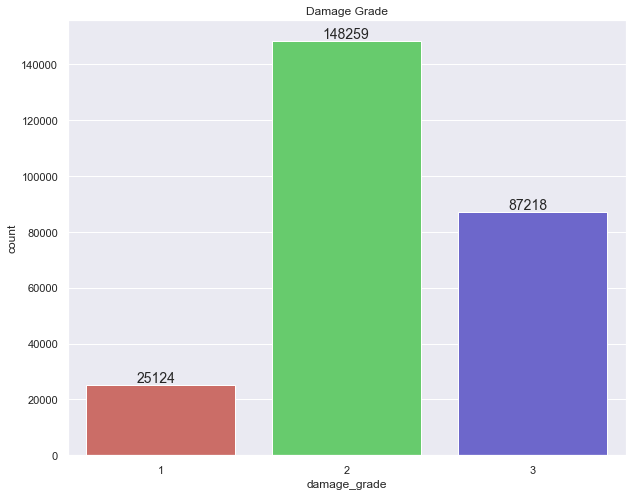

In [19]:
# Plotting the count of damage grade
plt.figure(figsize=(10,8))
a=sb.countplot("damage_grade",data=combined_train, palette='hls')
for i in a.patches:
    a.text(i.get_x()+0.27, i.get_height()+1000, \
            str(round((i.get_height()), 2)), fontsize=14)
plt.title("Damage Grade")

Based on the count plot above, it can be seen that most buildings suffered average damage followed by high damage and lastly low damage, and the 3 classes are highly imbalanced in terms of proportions.

So, we should keep an eye out for features where proportions of `damage_grade` are different across the feature as compared to the the proportions above. 

Examples of scenarios that we will look out for are:
- Low damage proportions larger than high damage.
- High damage proportions larger than average damage.

This is because if the various classes of a single feature have relatively different proportions of damage grades, there is a chance that the difference in damage grades are actually attributed to the various classes.

Furthermore, we shall explore the trends of `damage_grade` in each feature of a building that may give us insights on whether there might be a relationship between the feature and `damage_grade`.

We will now further explore using the various data types against `damage_grade`.

---
## Continuous features vs damage_grade
---
### Finding out if geographical location affects the damage grade - Stanley
Logically speaking, the location of the epicentre of the earthquake should affect the level of damage caused to nearby regions. So to test this hypothesis, we shall find out if geographical location affects the damage grade of the building, using geo_level_1_id.

Note that we do not include the more specific geo ids. (i.e. geo_level_2_id and geo_level_3_id)

- The area specificity increases with level 1, 2, 3 (i.e area specified becomes more narrow)
- Based on past attempts, there is a very wide range of level 2/3 ids and very few buildings sharing the same id.
- Hence, comparing number of buildings in geo level 2/3 ids give us no insights.
---
`geo_level_1_id` vs `damage_grade`

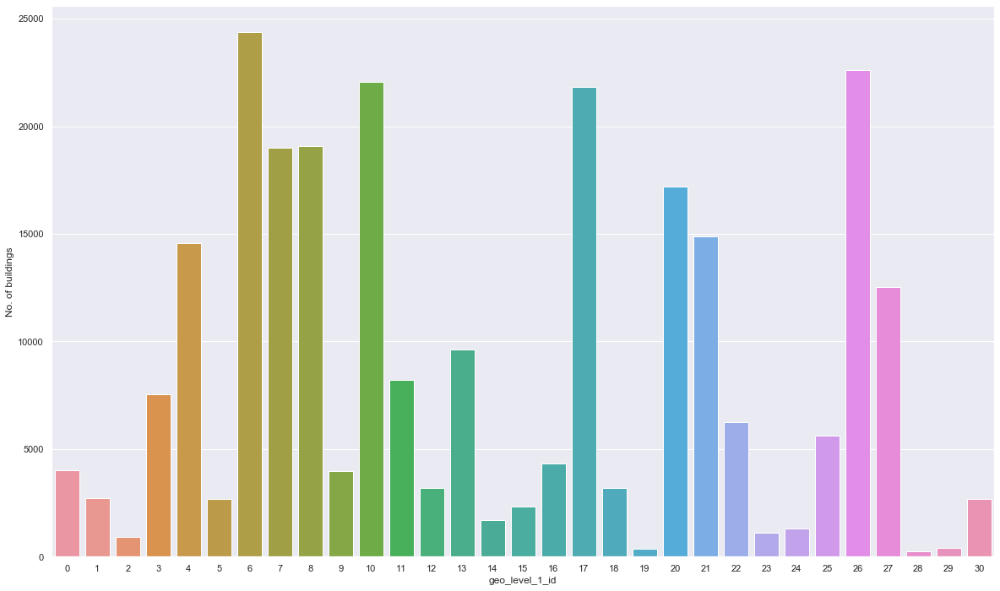

In [20]:
plt.figure(figsize=(20,12))
sb.countplot(x=combined_train['geo_level_1_id'])
plt.ylabel("No. of buildings")
plt.show()

In [21]:
geo_top10 = combined_train['geo_level_1_id'].value_counts().nlargest(10).index.tolist()
geo_top10=[str(i) for i in geo_top10]
geo_top10

['6', '26', '10', '17', '8', '7', '20', '21', '4', '27']

From the above, we can observe and obtain the 10 `geo_level_1_id` values `'6', '26', '10', '17', '8', '7', '20', '21', '4', '27'`, which are the 10 regions with largest number of buildings compared to other regions, hence we can conclude that locations among these `geo_level_1_id` values were regions that had more buildings affected by the earthquake. 

We shall then look into the proportions of `damage_grade` in all of the `geo_level_1_id` values.

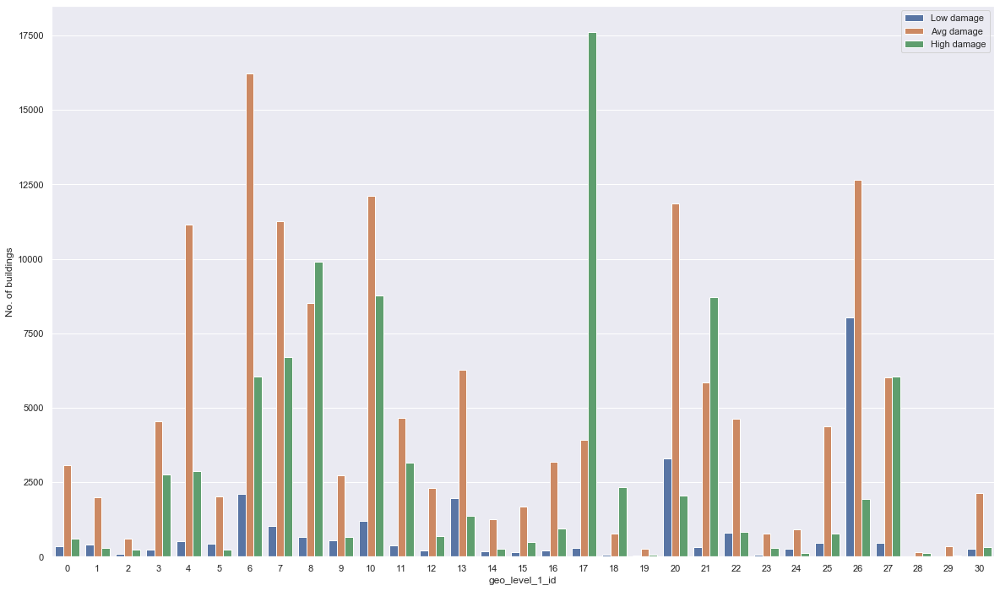

In [22]:
plt.figure(figsize=(20,12))
sb.countplot(x=combined_train['geo_level_1_id'],hue=combined_train["damage_grade"])
plt.ylabel("No. of buildings")
plt.legend(["Low damage","Avg damage","High damage"],loc="upper right")
plt.show()

From the plot above, there does not seem to show any obvious correlation between `geo_level_1_id` and `damage_grade`, and `geo_level_1_id` may appear to be a categorical feature here since there are no obvious trends. However, there are a few observations that we can make which still prove that geographical location indeed does affect level of damage to the buildings.

We can observe that at `geo_level_1_id` values `8, 17, 18` and `21`, the proportion of buildings which had `High damage` were more significant compared to `Average damage`. This either mean that the epicentre of the earthquake was nearer to the geographical region where these buildings are located such that the level of damage was higher, or that the buildings in these locations had or did not have features that contributed to higher level of damage. We shall further explore that in detail.

Furthermore, at `geo_level_1_id` values `13, 20` and `26`, the number of buildings which had `Low damage` were significantly larger than the number of buildings with `High damage`. Hence, we should also focus on buildings in these 3 level 1 ids to see if certain features of the buildings helped to reduce the level of damage.

---
#### Higher damaged buildings

In [23]:
high_damage = ['8','17','18','21']
high_damage_DF=combined_train[combined_train['geo_level_1_id'].isin(high_damage)]
high_damage_DF.head()

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,...,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,damage_grade
1,8,900,2812,2,10,8,7,o,r,n,...,False,False,False,False,False,False,False,False,False,2
2,21,363,8973,2,10,5,5,t,r,n,...,False,False,False,False,False,False,False,False,False,3
5,8,558,6089,2,10,9,5,t,r,n,...,False,False,False,False,False,False,False,False,False,2
10,17,1119,12188,2,20,9,6,t,r,q,...,False,False,False,False,False,False,False,False,False,3
11,17,1275,4004,1,10,8,4,t,u,n,...,False,False,False,False,False,False,False,False,False,2


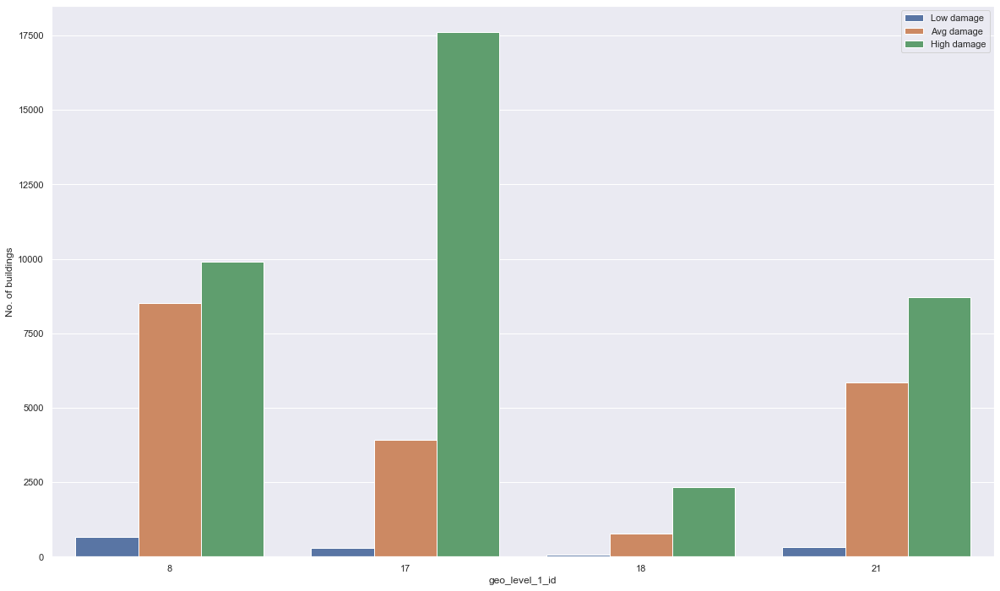

In [24]:
plt.figure(figsize=(20,12))
sb.countplot(x=high_damage_DF['geo_level_1_id'],hue=high_damage_DF["damage_grade"])
plt.ylabel("No. of buildings")
plt.legend(["Low damage","Avg damage","High damage"],loc="upper right")
plt.show()

For all correlation matrix that we will be using, we used the Spearman rank coefficient (as `damage_grade` is ordinal).

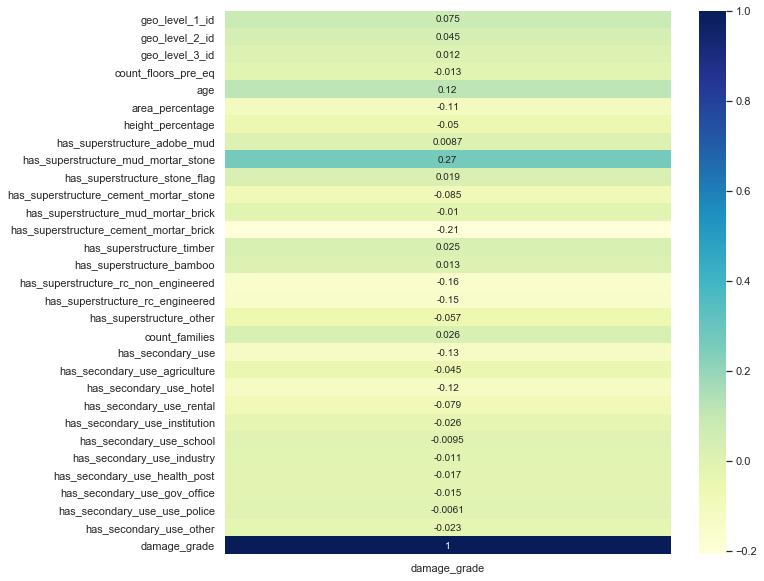

In [25]:
plt.figure(figsize=(10,10))
cor = high_damage_DF.corr(method='spearman')["damage_grade"]
cor = pd.DataFrame(cor)
sb.heatmap(cor,annot=True,cmap="YlGnBu")

In [26]:
print(cor['damage_grade'][numerical_columns].sort_values(ascending=False))
print()
print("Absolute values:")
print()
print(cor['damage_grade'][numerical_columns].abs().sort_values(ascending=False))

age                    0.115806
geo_level_1_id         0.075367
geo_level_2_id         0.044913
count_families         0.026150
geo_level_3_id         0.012143
count_floors_pre_eq   -0.012561
height_percentage     -0.050213
area_percentage       -0.106651
Name: damage_grade, dtype: float64

Absolute values:

age                    0.115806
area_percentage        0.106651
geo_level_1_id         0.075367
height_percentage      0.050213
geo_level_2_id         0.044913
count_families         0.026150
count_floors_pre_eq    0.012561
geo_level_3_id         0.012143
Name: damage_grade, dtype: float64


In [27]:
print(cor['damage_grade'][binary_columns].sort_values(ascending=False))
print()
print("Absolute values:")
print()
print(cor['damage_grade'][binary_columns].abs().sort_values(ascending=False))

has_superstructure_mud_mortar_stone       0.267349
has_superstructure_timber                 0.025233
has_superstructure_stone_flag             0.019147
has_superstructure_bamboo                 0.013195
has_superstructure_adobe_mud              0.008729
has_secondary_use_use_police             -0.006082
has_secondary_use_school                 -0.009464
has_superstructure_mud_mortar_brick      -0.010190
has_secondary_use_industry               -0.011240
has_secondary_use_gov_office             -0.015187
has_secondary_use_health_post            -0.016554
has_secondary_use_other                  -0.022643
has_secondary_use_institution            -0.025666
has_secondary_use_agriculture            -0.045199
has_superstructure_other                 -0.056562
has_secondary_use_rental                 -0.078748
has_superstructure_cement_mortar_stone   -0.084555
has_secondary_use_hotel                  -0.120306
has_secondary_use                        -0.129819
has_superstructure_rc_engineere

---
##### Positive correlation values: the presence of a specific feature is likely to `increase` the value of `damage_grade`

##### Negative correlation values: the presence of a specific feature is likely to `decrease` the value of `damage_grade`
---

From the correlation heatmap, we can observe that there are no correlation coefficients that suggest that any building features had a strong linear relationship with `damage_grade`. This might mean that many features are of similar importance.

Notable features:
- Top 3 Continous features: 
    - `age` (positive correlation)
    - `area_percentage` (negative correlation) 
    - `height_percentage` (positive correlation)
- Top 5 binary features:
    - `has_superstructure_mud_mortar_stone` (positive correlation)
    - `has_superstructure_cement_mortar_brick` (negative correlation) 
    - `has_superstructure_rc_non_engineered` (negative correlation) 
    - `has_superstructure_rc_engineered` (negative correlation) 
    - `has_secondary_use` (negative correlation) 

---
#### Lower damaged buildings

In [28]:
low_damage = ['13','20','26']
low_damage_DF=combined_train[combined_train['geo_level_1_id'].isin(low_damage)]
low_damage_DF.head()

,geo_level_1_id,geo_level_2_id,geo_level_3_id,count_floors_pre_eq,age,area_percentage,height_percentage,land_surface_condition,foundation_type,roof_type,...,has_secondary_use_hotel,has_secondary_use_rental,has_secondary_use_institution,has_secondary_use_school,has_secondary_use_industry,has_secondary_use_health_post,has_secondary_use_gov_office,has_secondary_use_use_police,has_secondary_use_other,damage_grade
7,20,323,12236,2,0,8,6,t,w,q,...,False,False,False,False,False,False,False,False,False,1
9,26,886,994,1,0,13,4,t,i,n,...,False,False,False,False,False,False,False,False,False,1
18,26,1401,3904,1,20,12,3,t,u,n,...,False,False,False,False,False,False,False,False,False,2
31,20,953,6651,2,15,13,5,t,w,q,...,False,False,False,False,False,False,False,False,False,2
36,13,305,5956,2,0,9,8,t,r,q,...,False,False,False,False,False,False,False,False,False,1


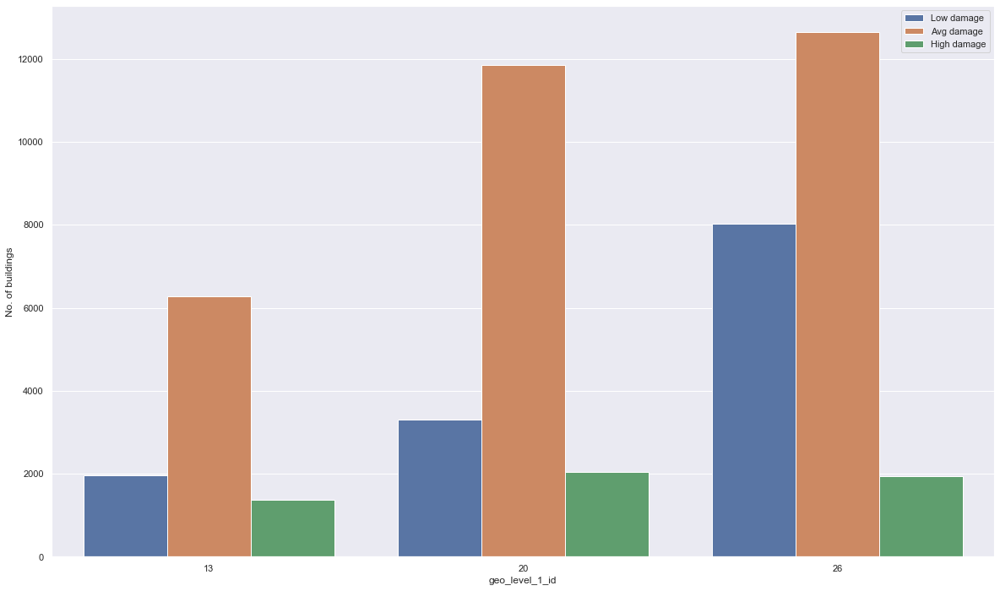

In [29]:
plt.figure(figsize=(20,12))
sb.countplot(x=low_damage_DF['geo_level_1_id'],hue=low_damage_DF["damage_grade"])
plt.ylabel("No. of buildings")
plt.legend(["Low damage","Avg damage","High damage"],loc="upper right")
plt.show()

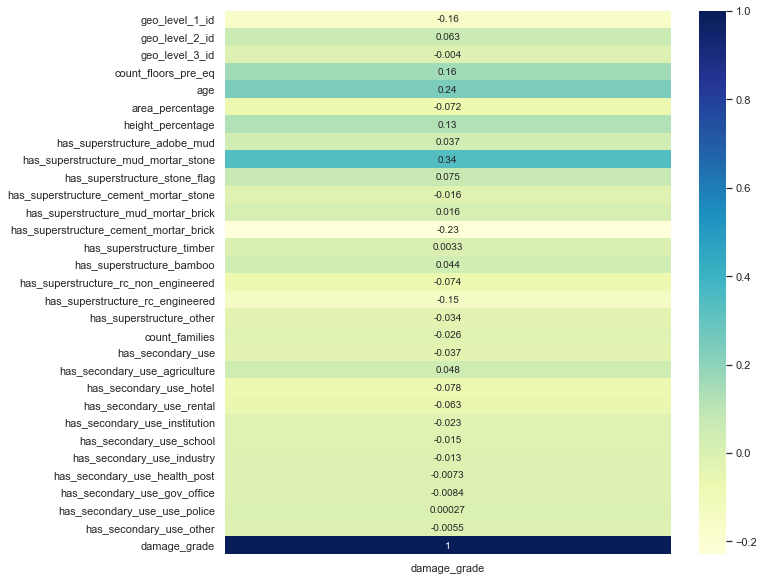

In [30]:
plt.figure(figsize=(10,10))
cor =  low_damage_DF.corr(method='spearman')["damage_grade"]
cor = pd.DataFrame(cor)
sb.heatmap(cor,annot=True,cmap="YlGnBu")

In [31]:
print(cor['damage_grade'][numerical_columns].sort_values(ascending=False))
print()
print("Absolute values:")
print()
print(cor['damage_grade'][numerical_columns].abs().sort_values(ascending=False))

age                    0.237973
count_floors_pre_eq    0.158504
height_percentage      0.125151
geo_level_2_id         0.063233
geo_level_3_id        -0.003991
count_families        -0.026466
area_percentage       -0.071820
geo_level_1_id        -0.162209
Name: damage_grade, dtype: float64

Absolute values:

age                    0.237973
geo_level_1_id         0.162209
count_floors_pre_eq    0.158504
height_percentage      0.125151
area_percentage        0.071820
geo_level_2_id         0.063233
count_families         0.026466
geo_level_3_id         0.003991
Name: damage_grade, dtype: float64


In [32]:
print(cor['damage_grade'][binary_columns].sort_values(ascending=False))
print()
print("Absolute values:")
print()
print(cor['damage_grade'][binary_columns].abs().sort_values(ascending=False))

has_superstructure_mud_mortar_stone       0.339351
has_superstructure_stone_flag             0.074957
has_secondary_use_agriculture             0.047998
has_superstructure_bamboo                 0.044407
has_superstructure_adobe_mud              0.037420
has_superstructure_mud_mortar_brick       0.015503
has_superstructure_timber                 0.003305
has_secondary_use_use_police              0.000271
has_secondary_use_other                  -0.005516
has_secondary_use_health_post            -0.007311
has_secondary_use_gov_office             -0.008367
has_secondary_use_industry               -0.012782
has_secondary_use_school                 -0.015353
has_superstructure_cement_mortar_stone   -0.015922
has_secondary_use_institution            -0.023192
has_superstructure_other                 -0.034367
has_secondary_use                        -0.036777
has_secondary_use_rental                 -0.062799
has_superstructure_rc_non_engineered     -0.074371
has_secondary_use_hotel        

Similarly, there are no features with strong correlation with `damage_grade`. However, there are many features that have similar relationship as we can see from below. 

Notable features: 
- Top 3 Continous features: 
    - `age` (positive correlation)      
    - `count_floors_pre_eq` (positive correlation)
    - `height_percentage` (positive correlation)
- Top 5 binary features:         
    - `has_superstructure_mud_mortar_stone` (positive correlation)      
    - `has_superstructure_cement_mortar_brick` (negative correlation)     
    - `has_superstructure_rc_engineered` (negative correlation)          
    - `has_secondary_use_hotel` (negative correlation)                 
    - `has_superstructure_stone_flag` (positive correlation)

---
#### Possible important features

We can see that even at both high damaged and low damaged regions, there are a few features of a building that stand out. We shall observe them in detail.

Continuous features:
- `age`: Older buildings have a higher chance to suffer higher damage
- `area_percentage`: Buildings with larger area have a higher chance to suffer lower damage
- **height of a building** from `count_floors_pre_eq` and `height_percentage`: Taller buildings have a higher chance to suffer higher damage

*Note: `geo_level_1_id` is not mentioned although it has one of the higher correlation value as we grouped the data according to this variable.*

Binary features:
- `has_superstructure_mud_mortar_stone`: Buildings with this superstructure have a higher chance to suffer higher damage    
- `has_superstructure_cement_mortar_brick`: Buildings with this superstructure have a higher chance to suffer lower damage
- `has_superstructure_rc_engineered`: Buildings with ths superstructure have a higher chance to suffer lower damage        




## Other visualizations 
### - Garg Astha (majority of codes), Chiah Soon (observations) and Stanley (some codes and observations)

---
### Finding out if age affects the damage grade 
`age` vs `damage_grade`

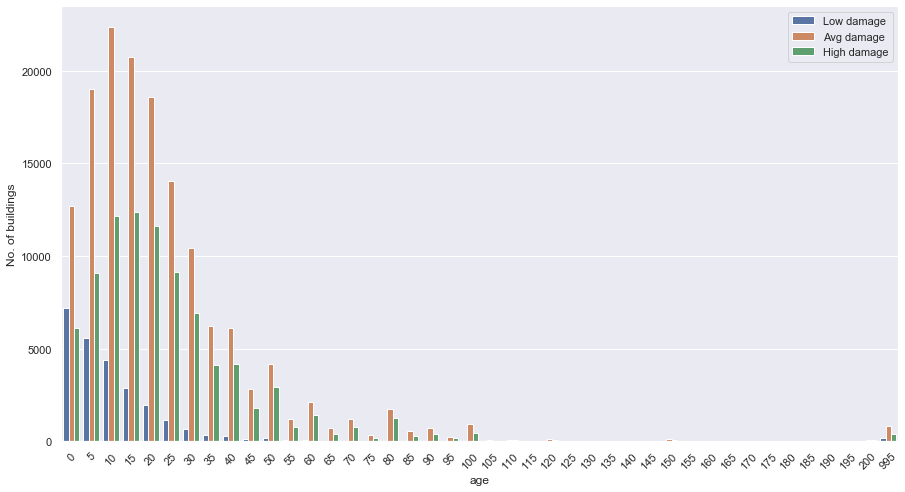

In [33]:
plt.figure(figsize=(15, 8))
sb.countplot(x=combined_train['age'],hue=combined_train["damage_grade"])
plt.ylabel("No. of buildings")
plt.legend(["Low damage","Avg damage","High damage"],loc="upper right")
plt.xticks(rotation=45)
plt.show()

Several observations can be extracted:
- Majority of the buildings are age 50 and below.
- Based on the chart above, we can see that despite the old age of building, it does not mean that the buildings suffered high damage as seen where most of the older buildings are in the category of average damage.

Let's look at a smaller range of age in the following plots.

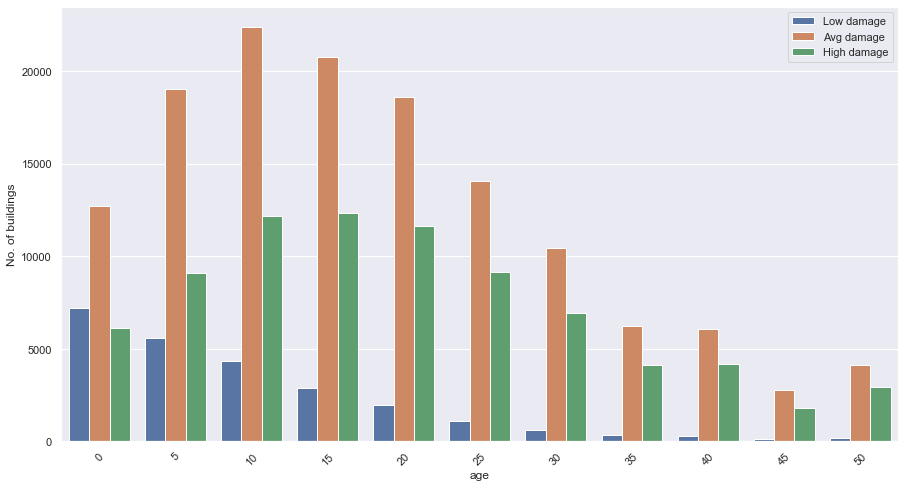

In [34]:
age_below50 = combined_train.loc[combined_train['age']<=50]
plt.figure(figsize=(15, 8))
sb.countplot(x=age_below50['age'],hue=combined_train["damage_grade"])
plt.ylabel("No. of buildings")
plt.legend(["Low damage","Avg damage","High damage"],loc="upper right")
plt.xticks(rotation=45)
plt.show()

- We can see clearly the number of buildings with low damage decreases as age increases. Thus, this allows us to conclude that age is one of the features that do affect the `damage_grade` of the building as proportion of low damage buildings decreases as age increases.

---
### Finding out if area percentage of a building affects the damage grade
`area_percentage` vs `damage_grade`

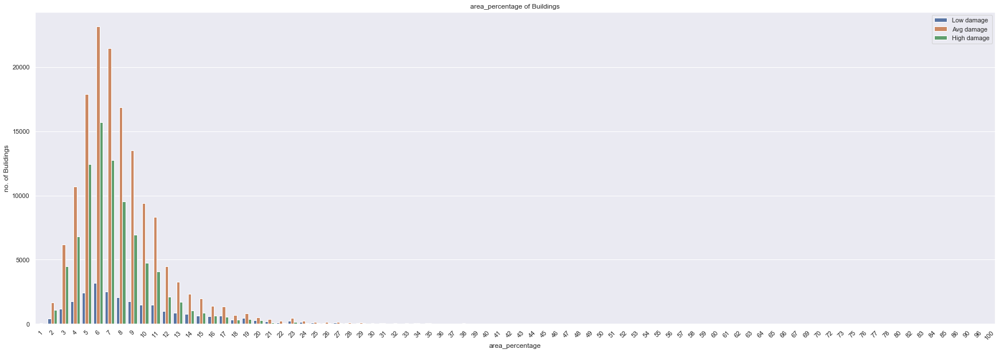

In [35]:
#plotting area_percentage of building
plt.figure(figsize=(30,10))
sb.countplot(x=combined_train["area_percentage"],hue=combined_train["damage_grade"])
plt.ylabel("no. of Bulidings")
plt.title("area_percentage of Buildings")
plt.legend(["Low damage","Avg damage","High damage"],loc="upper right")
plt.xticks(rotation=45)
plt.show()

The plot seems very concentrated below 25 percent of area. Let's narrow down the range to that.

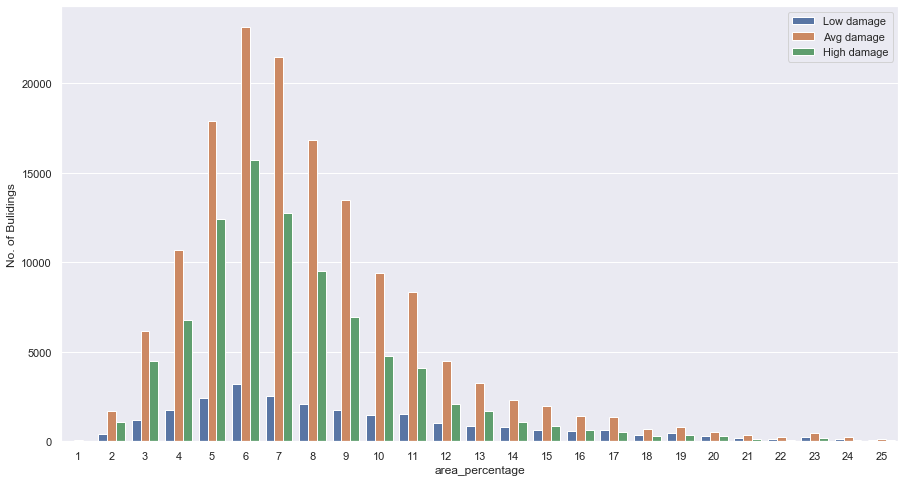

In [36]:
plt.figure(figsize=(15,8))
area_below25 = combined_train.loc[combined_train['area_percentage']<=25]
sb.countplot(x=area_below25["area_percentage"],hue=combined_train["damage_grade"])
plt.ylabel("No. of Bulidings")
plt.legend(["Low damage","Avg damage","High damage"],loc="upper right")
plt.show()

In [37]:
import plotly.express as px

fig = px.violin(combined_train, y="area_percentage",x='damage_grade', box=True, color="damage_grade", points='all')
fig.show()

Some observations:
- Majority of the proportions does not seem to be different from normal proportions of `damage_grade`
- However as `area_percentage` increases, ratio of low-damage buildings against other buildings increases, although not very significant until large percentage.
- Towards larger area percentage of around 16 and above, it seems that the proportions of low-damaged buildings are consistently higher than proportions of high-damaged buildings.
- Hence the conclusion that can be made is that buildings with significantly larger `area_percentage` may lower `damage_grade`.

---
### Finding out if height of a building affects the damage grade 

This will be done by looking at `height_percentage` and `count_floors_pre_eq` against `damage_grade`.

---
`height_percentage` vs `damage_grade`

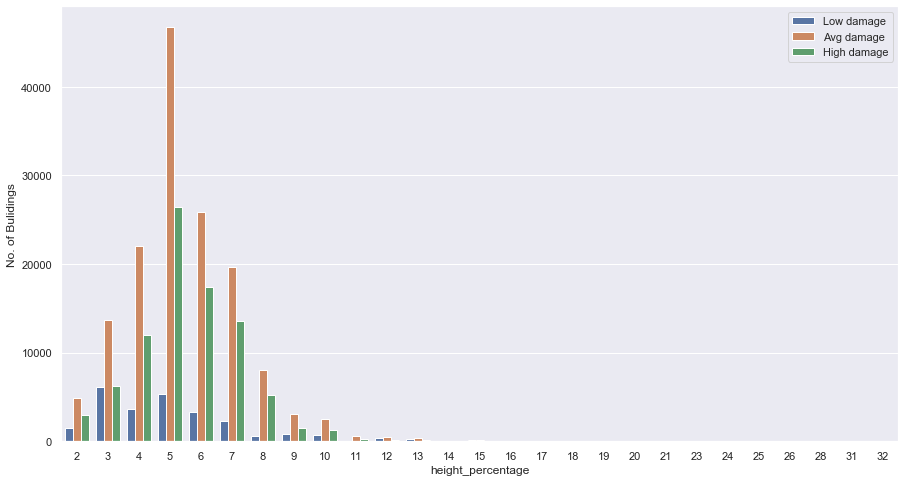

In [38]:
plt.figure(figsize=(15,8))
sb.countplot(x=combined_train["height_percentage"],hue=combined_train["damage_grade"])
plt.ylabel("No. of Bulidings")
plt.legend(["Low damage","Avg damage","High damage"],loc="upper right")
plt.show()

In [39]:
import plotly.express as px

fig = px.violin(combined_train, y="height_percentage",x='damage_grade', box=True, color="damage_grade", points='all')
fig.show()

## An interesting observation - Garg Astha

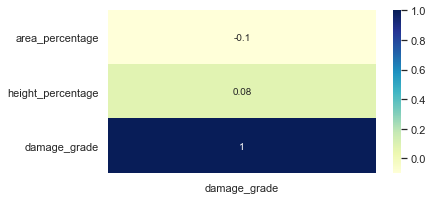

In [40]:
subset=['area_percentage', 'height_percentage', 'damage_grade']
plt.figure(figsize=(6,3))
cor=combined_train[subset].corr(method='spearman')["damage_grade"]
cor=pd.DataFrame(cor)
sb.heatmap(cor,annot=True,cmap="YlGnBu")

As it can be seen above, the correlation of `area_percentage`= -0.1 and `height_percentage`= 0.08.
However, combining these two features gives a new feature with better negative correlation than both of them as shown in the following.

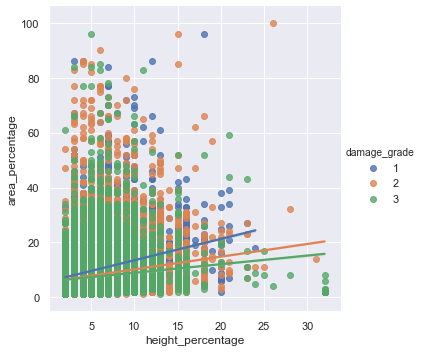

In [41]:
sb.lmplot(y='area_percentage',x='height_percentage',data=combined_train,hue='damage_grade')

In [42]:
combined_train['ratio']=combined_train['area_percentage']/ combined_train['height_percentage']

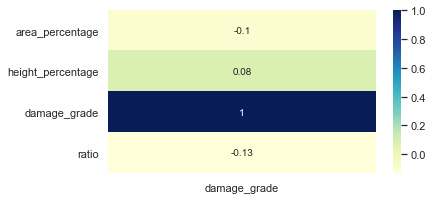

In [43]:
subset+=['ratio']
plt.figure(figsize=(6,3))
cor=combined_train[subset].corr(method='spearman')["damage_grade"]
cor=pd.DataFrame(cor)
sb.heatmap(cor,annot=True,cmap="YlGnBu")

This can allow use to conclude that the larger the ratio of area/height (meaning higher area, lower height), the higher probability for the `damage_grade` of the building to be lower.

---
`count_floors_pre_eq` vs `damage_grade`

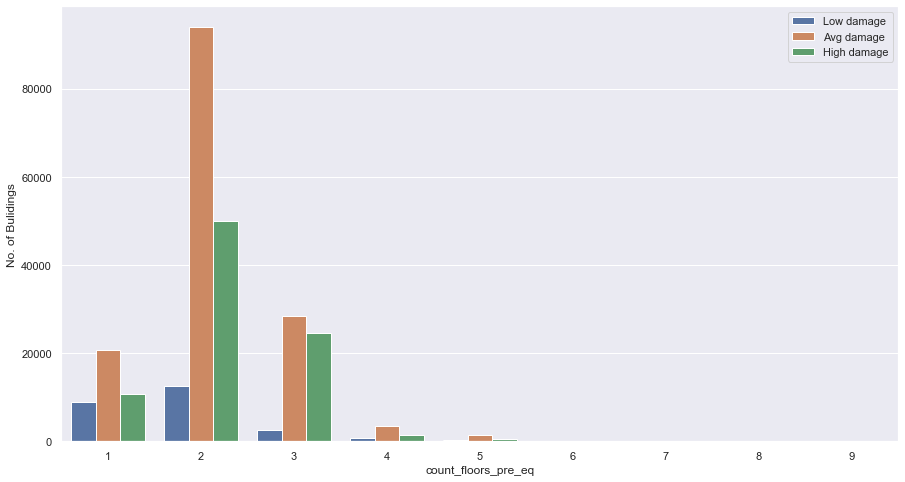

In [44]:
plt.figure(figsize=(15,8))
sb.countplot(x=combined_train["count_floors_pre_eq"],hue=combined_train["damage_grade"])
plt.ylabel("No. of Bulidings")
plt.legend(["Low damage","Avg damage","High damage"],loc="upper right")
plt.show()

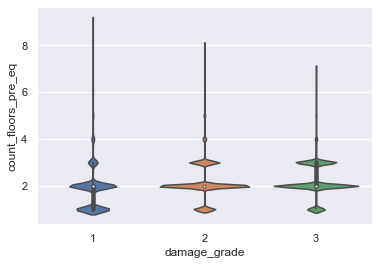

In [45]:
sb.violinplot(data=combined_train, x="damage_grade", y="count_floors_pre_eq")

Again, from the count plot, the only obvious observation that can be made is that the number of buildings with low damage drops significantly after 2 floors of buildings. The violin plot offers a more obvious trend where the proportion of low damage buildings decreases significantly as the number of floors increases.

We can thus conclude that lower height of a building may lower the `damage_grade` in the event of an earthquake.

---
## Categorical features vs damage_grade 
### - Garg Astha (codes), Chiah Soon and Stanley (observations)
---
For categorical features, we will create count plots to check whether a certain category of feature result in different proportions of `damage_grade`. Again, we want to keep an eye out for features where the proportions of different `damage_grade` are different across different categories.

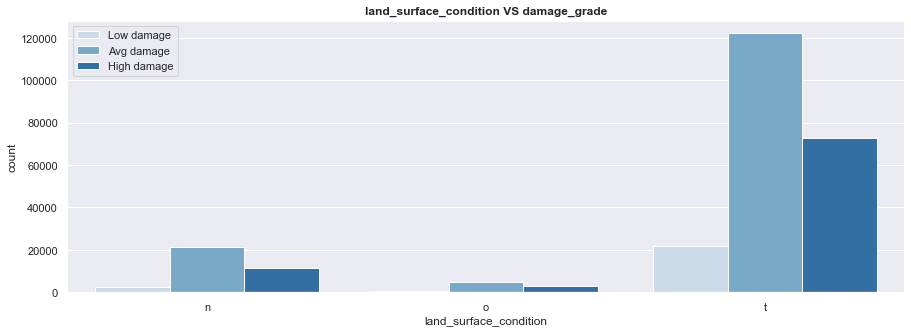

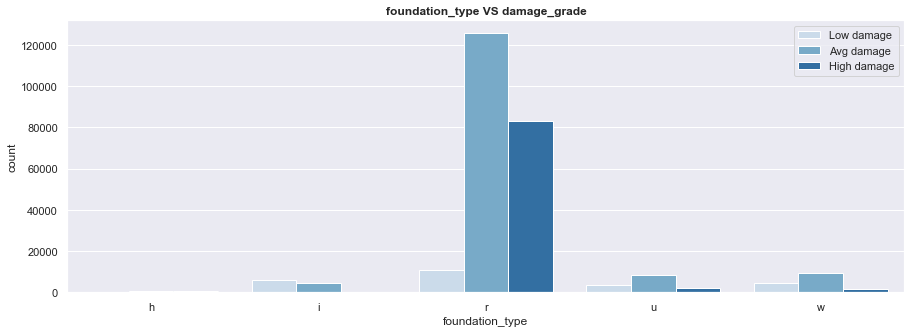

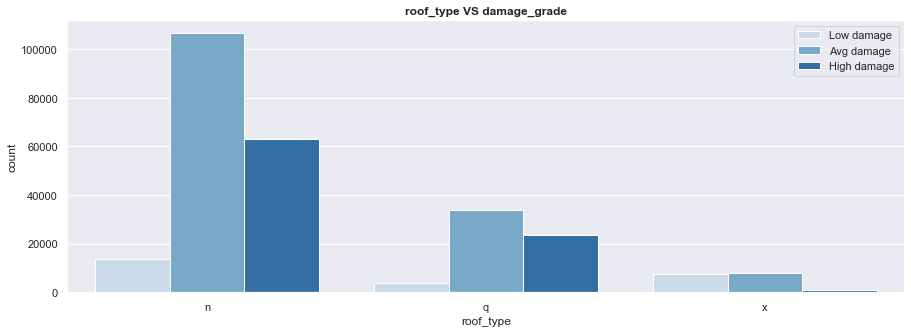

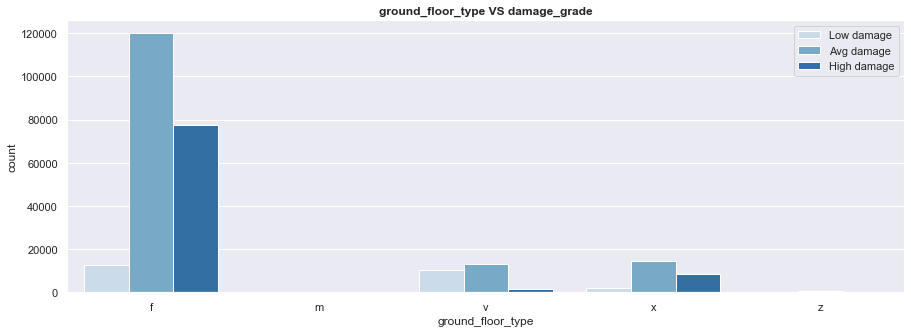

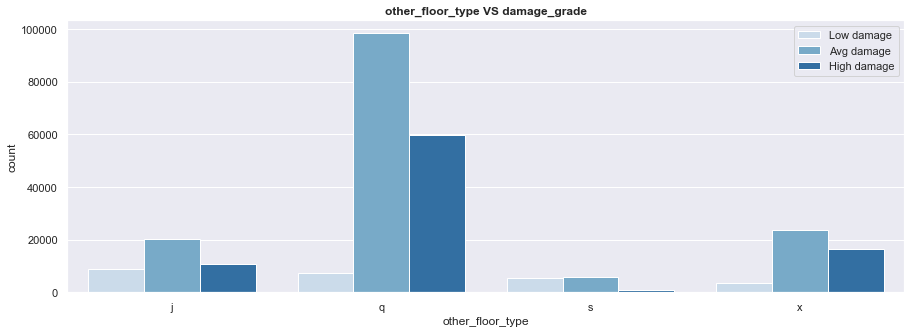

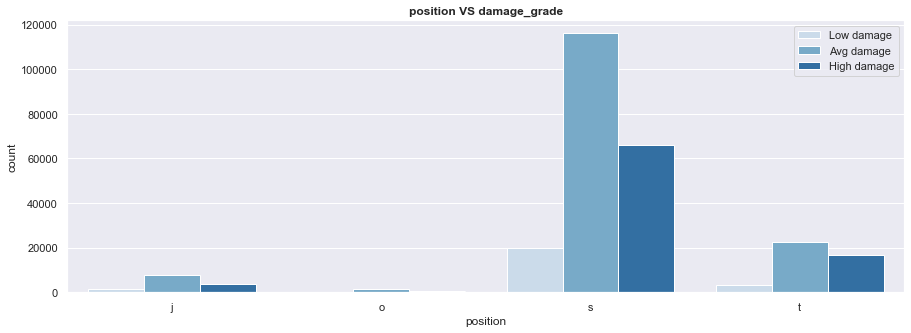

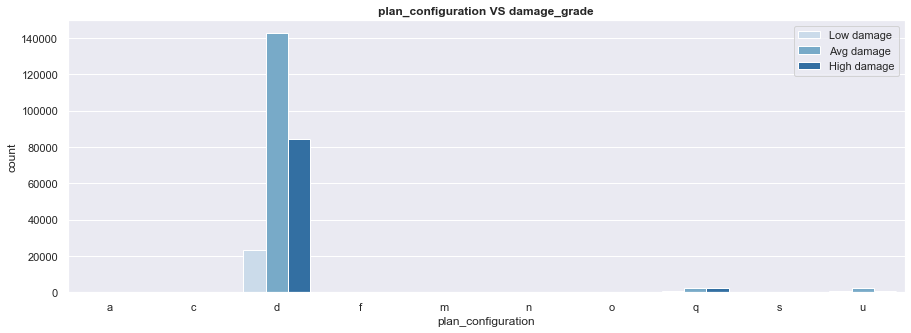

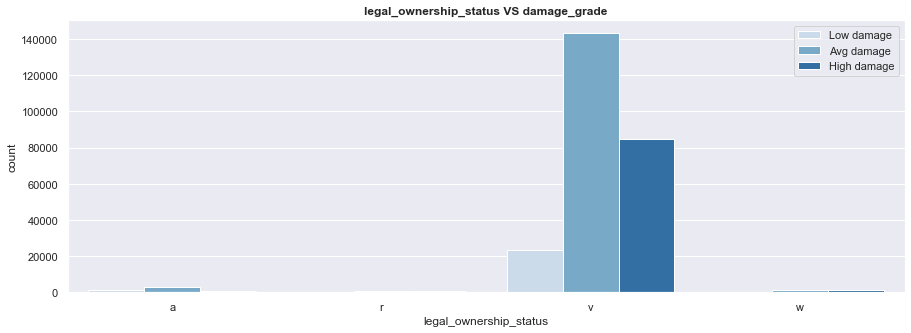

In [46]:
for col in categorical_columns:
    plt.figure(figsize=(15,5))
    sb.countplot(combined_train[col].sort_values(ascending=True),hue=combined_train['damage_grade'],palette="Blues")
    plt.title(col+ " VS damage_grade",fontweight="bold")
    plt.legend(["Low damage","Avg damage","High damage"]) 
    plt.show()

Main observation: The classes in the various features are highly imbalanced and there is no way to conclude which feature may be the best in affecting `damage_grade` directly.

Some observations:
- `foundation_type`: most of the buildings are in category `r`, and `r` is the only category that has more `High damage` proportions compared to `Low damage`, thus this means that the feature might have higher importance in classifying `damage_grade` when it comes to `High damage`, and also seems that category `r` may actually cause `damage_grade` to increase
- `roof_type`: category `x` has more `Low damage` proportions, thus category `x` seem to  decrease `damage_grade`
- `ground_floor_type`: category `v` has more `Low damage` proportions, thus category `v` seem to  decrease `damage_grade` 
- `other_floor_type`: category `s` has more `Low damage` proportions, thus category `s` seem to  decrease `damage_grade`

These observations will be explored later in detail.

---
## Binary features vs damage_grade - Garg Astha (codes) and Stanley (observations)

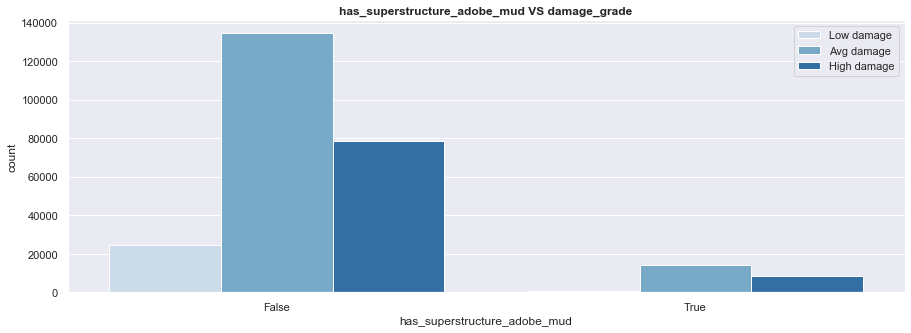

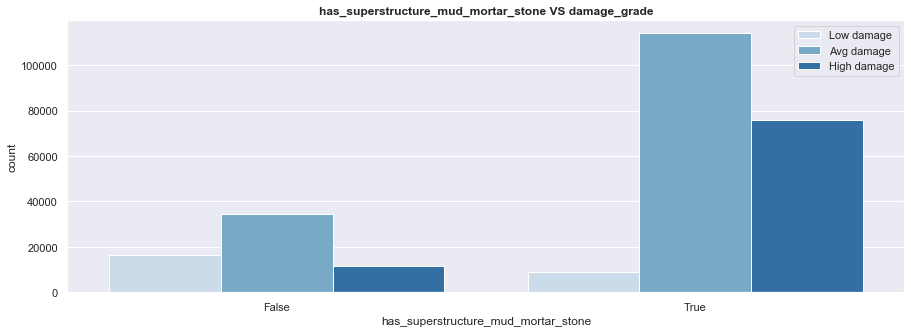

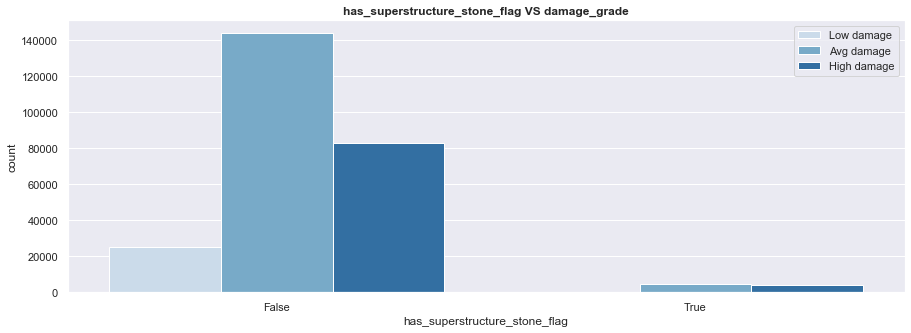

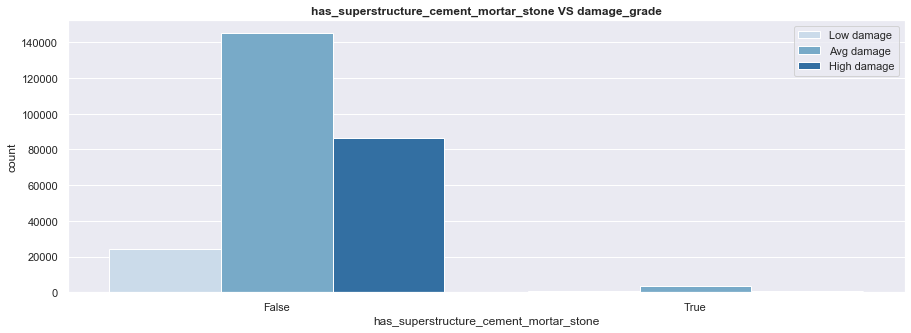

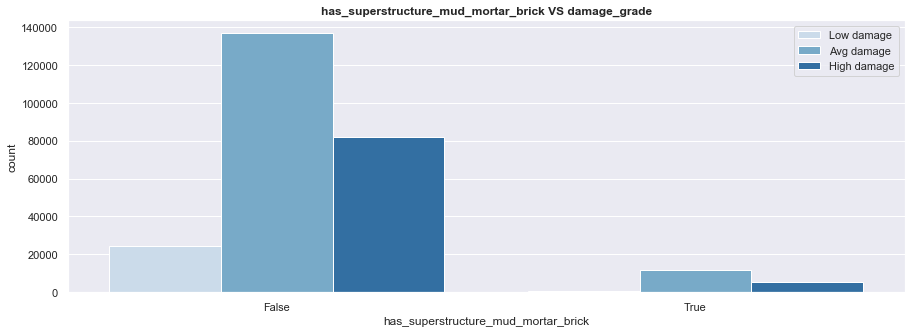

...

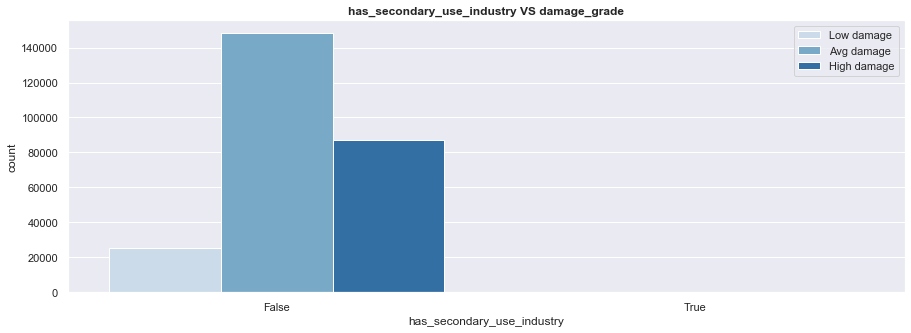

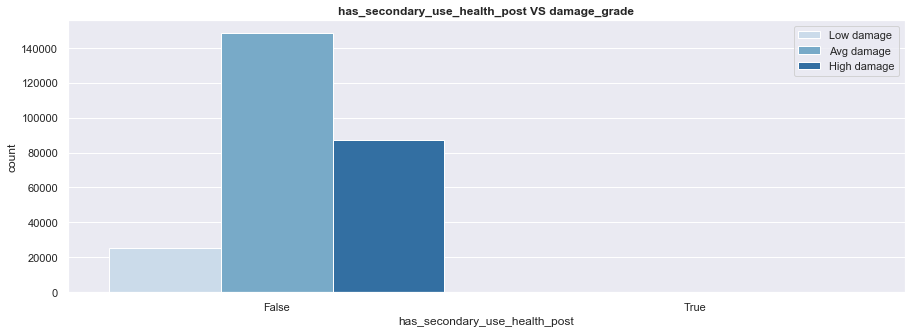

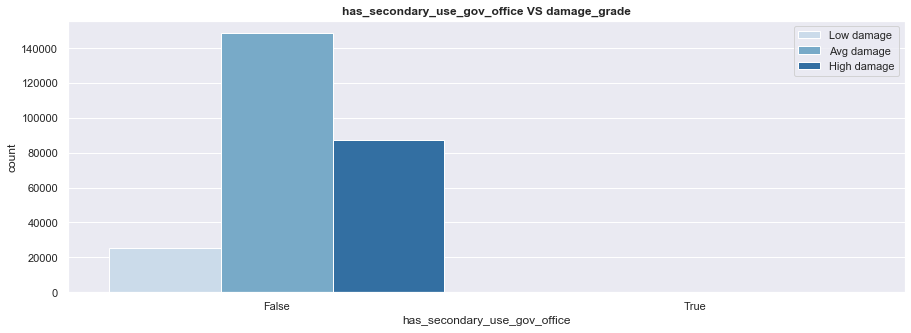

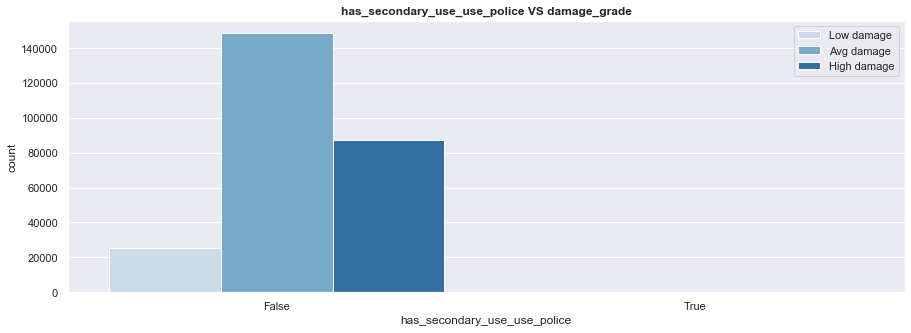

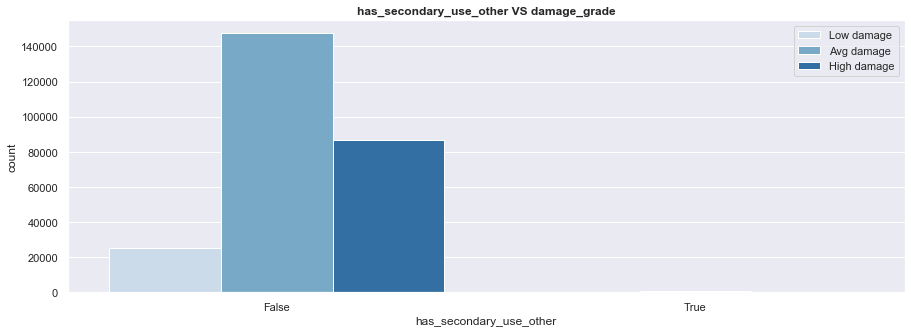

In [47]:
for col in binary_columns:
    plt.figure(figsize=(15,5))
    sb.countplot(combined_train[col],hue=combined_train['damage_grade'],palette="Blues")
    plt.title(col+ " VS damage_grade",fontweight="bold")
    plt.legend(["Low damage","Avg damage","High damage"]) 
    plt.show()

Main observation: Again, the true/false classes are highly imbalanced in each feature (superstructure/secondary use), as seen in the catplots above. Thus, there is no way to conclude which feature may be the best in affecting `damage_grade` directly.

Some observations to be made:
- `has_superstructure_mud_mortar_stone`: `True` has more `High damage` proportions compared to `Low damage` - suggests that having this superstructure might seem to increase `damage_grade`
- `has_superstructure_cement_mortar_brick`: `True` has more `Low damage` proportions compared to `High damage` - suggests that having this superstructure might seem to reduce `damage_grade`
- `has_superstructure_rc_non_engineered`:`True` has more `Low damage` proportions compared to `High damage` -  suggests that having this superstructure might seem to reduce `damage_grade`
- `has_superstructure_rc_engineered`: `True` has **most** `Low damage` buildings compared to `Avg damage` or `High damage` - highly suggests that having this superstructure seem to reduce `damage_grade`, however the ratio of having this superstructure for buildings are very low, which can mean that it is rare for buildings to have such a superstructure
- `has_secondary_use_hotel`: `True` has more `Low damage` proportions compared to `High damage` -  -  suggests that buildings built for hotels might seem to reduce `damage_grade`

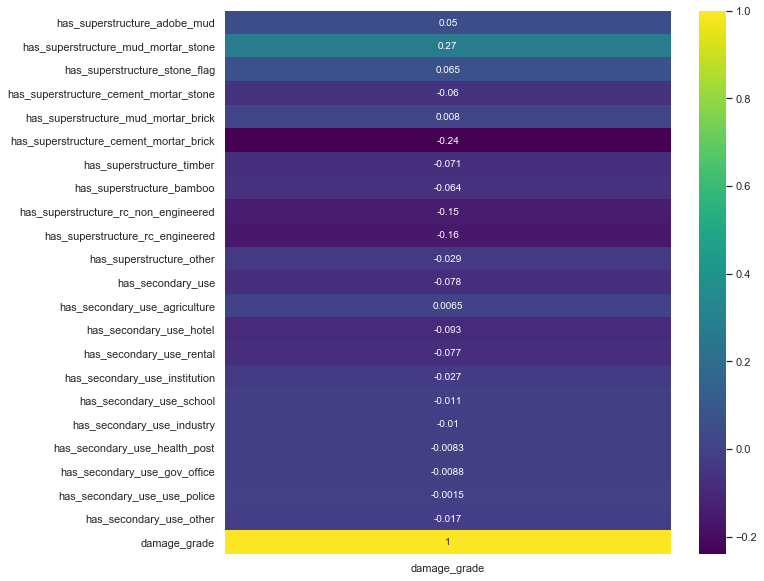

In [48]:
plt.figure(figsize=(10,10))
subset = binary_columns + ["damage_grade"]
cor = combined_train[subset].corr(method='spearman')["damage_grade"]
cor = pd.DataFrame(cor)
sb.heatmap(cor,annot=True,cmap="viridis")

Notable features from correlation heatmap:
- `has_superstructure_mud_mortar_stone`
- `has_superstructure_cement_mortar_brick`
- `has_superstructure_rc_engineered`
- `has_superstructure_rc_non_engineered`
- `has_secondary_use_hotel`

#### Complete Heatmap of the Correlation Matrix

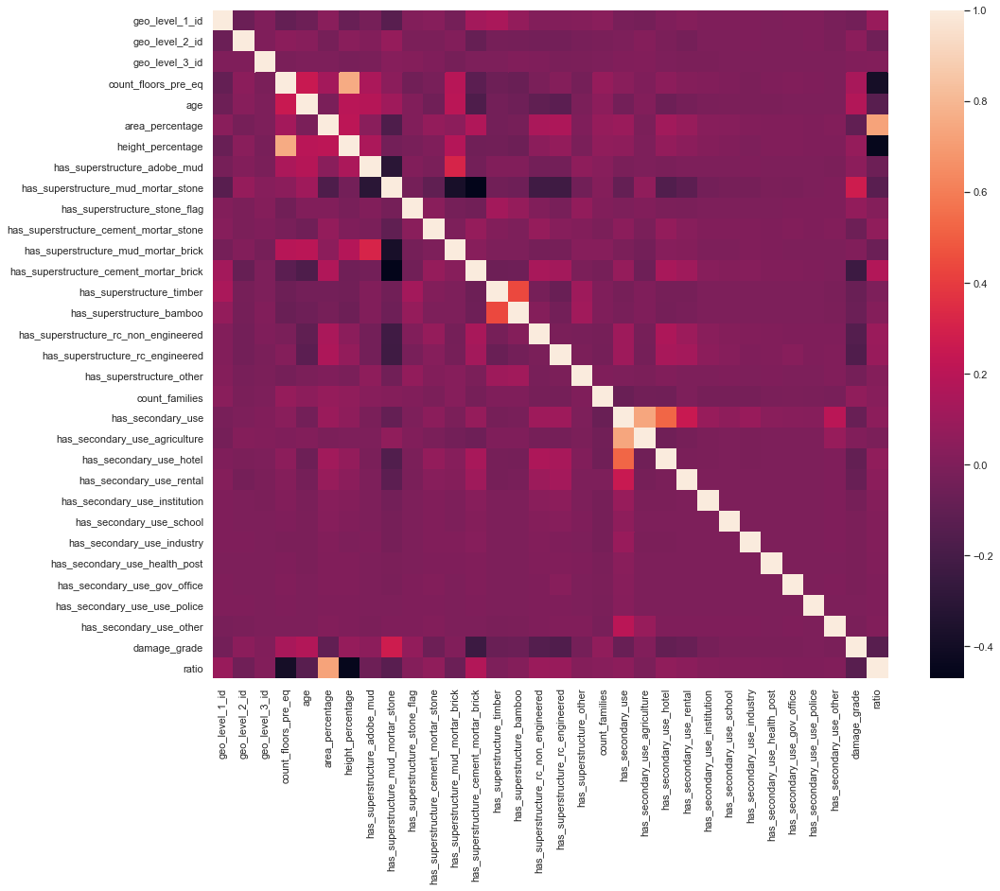

In [49]:
plt.figure(figsize=(16,13))
data_corr = combined_train.corr(method='spearman')
sb.heatmap(data_corr)
plt.show()

### Some other observations
1. `has_superstructure_timber` bears strong correlation with `has_superstructure_bamboo` which could mean they are used together.
2. `has_secondary_use` bears maximum correlation with `has_secondary_use_agriculture` followed by `has_secondary_use_hotel`, which could mean most of the buildings are used for agriculture followed by hotels

---
### Conclusion: Exploratory Analysis of Visualised Data
---
It may seem that there are features that may possibly increase or decrease the `damage_grade` of the building, as summarised below based on data type.

Continuous features (in descending order - not including geographical location):
- Geographical location (`geo_level_1_id`) - specific locations can expect buildings to have an increase or decrease in `damage_grade`
- Age of a building (`age`) - younger buildings seem to have reduced `damage_grade`
- Height of a building (`height_percentage` and `count_floors_pre_eq`) - shorter buildings seem to reduce `damage_grade`
- Area percentage of a building (`area_percentage`) - larger area percentage seem to reduce `damage_grade`

Categorical features (in no particular order as order cannot be determined yet):
- Type of foundation used (`foundation_type`) - type `r` seem to increase `damage_grade`
- Type of roof used (`roof_type`) - type `x` seem to decrease `damage_grade`
- Type of ground floor used (`ground_floor_type`) - type `v` seem to decrease `damage_grade`
- Type of floors used for other floors (`other_floor_type`) - type `s` seem to decrease `damage_grade`

Binary features (in descending order):
- Superstructure mud mortar stone(`has_superstructure_mortar_stone`) may increase `damage_grade`
- Superstructure cement mortar brick (`has_superstructure_cement_mortar_brick`) may reduce `damage_grade`
- Superstructure reinforced-concrete and engineered (`has_superstructure_rc_engineered`) may reduce `damage_grade`
- Superstructure reinforced-concrete and non-engineered (`has_superstructure_rc_non_engineered`) may reduce `damage_grade`
- Buildings constructed to be used as hotels (`has_secondary_use_hotel`) may reduce `damage_grade`

---
## Feature selection using SelectKBest - Chiah Soon and Stanley
---
While we have shortlisted the notable features from visual analysis, they are less accurate since they are shortlisted by visual observations. We shall move on to a more accurate way to select features that affect `damage_grade`, by using the **SelectKBest** function that provides different statistical tests to find out which features have the strongest relationship with `damage_grade`.

#### Data Preparation

In [50]:
from sklearn.feature_selection import chi2, f_classif, mutual_info_classif
from sklearn.feature_selection import SelectKBest

# Converting alphabetical categorical columns to numeric categorical
for column in categorical_columns:
    train_values[column] = train_values[column].astype('category').cat.codes
for column in binary_columns:
    train_values[column] = train_values[column].astype('bool')
    
train_values.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 260601 entries, 0 to 260600
Data columns (total 38 columns):
 #   Column                                  Non-Null Count   Dtype
---  ------                                  --------------   -----
 0   geo_level_1_id                          260601 non-null  int64
 1   geo_level_2_id                          260601 non-null  int64
 2   geo_level_3_id                          260601 non-null  int64
 3   count_floors_pre_eq                     260601 non-null  int64
 4   age                                     260601 non-null  int64
 5   area_percentage                         260601 non-null  int64
 6   height_percentage                       260601 non-null  int64
 7   land_surface_condition                  260601 non-null  int8 
 8   foundation_type                         260601 non-null  int8 
 9   roof_type                               260601 non-null  int8 
 10  ground_floor_type                       260601 non-null  int8 
 11  

#### Top 3 continuous features (out of 8)

In [51]:
numerical_x_train = train_values[numerical_columns]
selector = SelectKBest(f_classif, 3).fit(numerical_x_train, train_labels.values.ravel())
cols = selector.get_support(indices=True)
features_df_new = numerical_x_train.iloc[:,cols]
best_num = list(features_df_new)
print(best_num)

['geo_level_1_id', 'count_floors_pre_eq', 'area_percentage']


#### Top 3 categorical features (out of 8)

In [52]:
categorical_x_train = train_values[categorical_columns]
selector = SelectKBest(mutual_info_classif, 3).fit(categorical_x_train, train_labels.values.ravel())
cols = selector.get_support(indices=True)
features_df_new = categorical_x_train.iloc[:,cols]
best_cat = list(features_df_new)
print(best_cat)

['foundation_type', 'ground_floor_type', 'other_floor_type']


#### Top 5 binary features (out of 22)

In [53]:
binary_x_train = train_values[binary_columns]
selector = SelectKBest(mutual_info_classif, 5).fit(binary_x_train, train_labels.values.ravel())
cols = selector.get_support(indices=True)
features_df_new = binary_x_train.iloc[:,cols]
best_bin = list(features_df_new)
print(best_bin)

['has_superstructure_mud_mortar_stone', 'has_superstructure_cement_mortar_brick', 'has_superstructure_rc_non_engineered', 'has_superstructure_rc_engineered', 'has_secondary_use_hotel']


---
### Overall Conclusion: 

With statistical tests affirming our conclusions made in the data visualisation section, we can reiterate the following conclusions according to each data type in **descending order**:

Continuous features:
- Geographical location (`geo_level_1_id`) - specific locations can expect buildings to have an increase or decrease in `damage_grade`
- Height of a building (`height_percentage` and `count_floors_pre_eq`) - shorter buildings seem to reduce `damage_grade`
- Area percentage of a building (`area_percentage`) - larger area percentage seem to reduce `damage_grade`
- Age of a building (`age`) - younger buildings seem to have reduced `damage_grade`

Categorical features:
- Type of foundation used (`foundation_type`) - type `r` seem to increase `damage_grade`
- Type of ground floor used (`ground_floor_type`) - ground floor type `v` seem to decrease `damage_grade` 
- Type of floors used for other floors (`other_floor_type`) - other floor type `s` seem to decrease `damage_grade`
- Type of roof used (`roof_type`) - type `x` seem to decrease `damage_grade`

Binary features:
- Superstructure mud mortar stone(`has_superstructure_mortar_stone`) may increase `damage_grade`
- Superstructure cement mortar brick (`has_superstructure_cement_mortar_brick`) may reduce `damage_grade`
- Superstructure reinforced-concrete and engineered (`has_superstructure_rc_engineered`) may reduce `damage_grade`
- Superstructure reinforced-concrete and non-engineered (`has_superstructure_rc_non_engineered`) may reduce `damage_grade`
- Buildings constructed to be used as hotels (`has_secondary_use_hotel`) may reduce `damage_grade`

--- 
# ~ End of Part 1 ~
---